<a href="https://colab.research.google.com/github/DivjotBanga/DivjotBanga.github.io/blob/master/bank_data_second.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# All the install

In [0]:
!pip install pandas==0.24.0

In [0]:
from google.colab import drive
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from imblearn.over_sampling import SMOTE,ADASYN
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn import model_selection
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

# Reading and modifying dataframe

In [0]:
drive.mount('./data')

Drive already mounted at ./data; to attempt to forcibly remount, call drive.mount("./data", force_remount=True).


In [0]:
bank_data_o = pd.read_csv('./data/My Drive/ML_training/bank-full.csv')
bank_data = bank_data_o.loc[:,bank_data_o.columns != "duration"]
#Converting dependent variable categorical to dummy
y = pd.get_dummies(bank_data['Target'], columns = ['Target'], drop_first = True)
bank_data.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,Target
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,1,-1,0,unknown,no


In [0]:
bank_data.isnull().any()

age          False
job          False
marital      False
education    False
default      False
balance      False
housing      False
loan         False
contact      False
day          False
month        False
campaign     False
pdays        False
previous     False
poutcome     False
Target       False
dtype: bool

In [0]:
bank_data.describe()

,age,balance,day,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,63.000000,871.000000,275.000000


In [0]:
bank_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 16 columns):
age          45211 non-null int64
job          45211 non-null object
marital      45211 non-null object
education    45211 non-null object
default      45211 non-null object
balance      45211 non-null int64
housing      45211 non-null object
loan         45211 non-null object
contact      45211 non-null object
day          45211 non-null int64
month        45211 non-null object
campaign     45211 non-null int64
pdays        45211 non-null int64
previous     45211 non-null int64
poutcome     45211 non-null object
Target       45211 non-null object
dtypes: int64(6), object(10)
memory usage: 5.5+ MB


In [0]:
org_bank_data = bank_data.copy()
columns = bank_data.columns
for each in columns:
  print(each+':\n', bank_data[each].unique())
  print(each+' count :\n', bank_data[each].value_counts())

age:
 [58 44 33 47 35 28 42 43 41 29 53 57 51 45 60 56 32 25 40 39 52 46 36 49
 59 37 50 54 55 48 24 38 31 30 27 34 23 26 61 22 21 20 66 62 83 75 67 70
 65 68 64 69 72 71 19 76 85 63 90 82 73 74 78 80 94 79 77 86 95 81 18 89
 84 87 92 93 88]
age count :
 32    2085
31    1996
33    1972
34    1930
35    1894
36    1806
30    1757
37    1696
39    1487
38    1466
40    1355
41    1291
42    1242
45    1216
29    1185
46    1175
43    1161
44    1136
47    1088
28    1038
48     997
49     994
50     939
51     936
52     911
27     909
53     891
57     828
54     811
55     806
      ... 
67      54
71      54
72      52
20      50
77      44
73      44
69      44
75      39
74      37
68      36
19      35
76      32
80      31
78      30
79      25
83      22
82      19
81      17
18      12
84       9
86       9
85       5
87       4
89       3
88       2
90       2
92       2
93       2
95       2
94       1
Name: age, Length: 77, dtype: int64
job:
 ['management' 'technician' 'entr

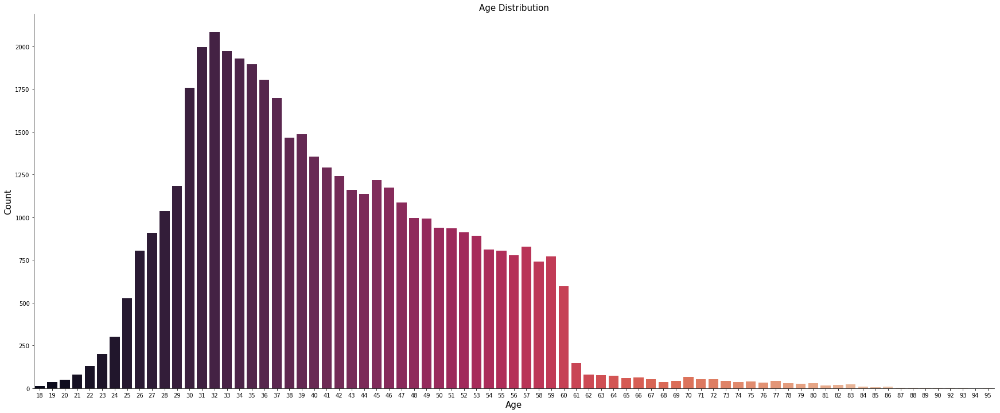

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(30, 12)
sns.countplot(x = 'age',  palette="rocket", data = org_bank_data)
ax.set_xlabel('Age', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Age Distribution', fontsize=15)
sns.despine()

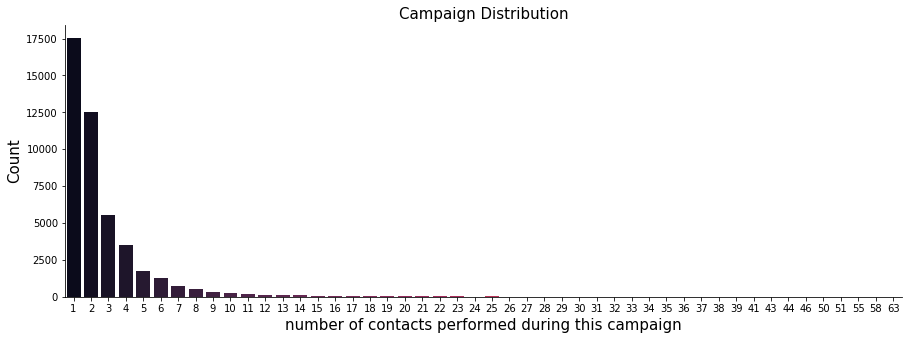

In [0]:

fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'campaign',  palette="rocket", data = org_bank_data)
ax.set_xlabel('number of contacts performed during this campaign', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Campaign Distribution', fontsize=15)
sns.despine()

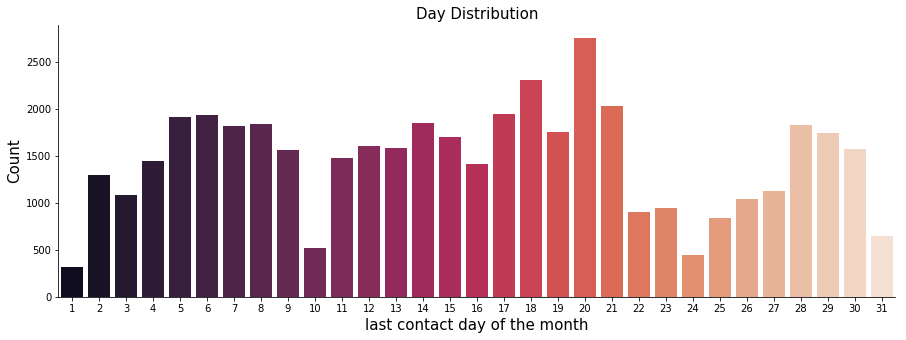

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'day',  palette="rocket", data = org_bank_data)
ax.set_xlabel('last contact day of the month', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Day Distribution', fontsize=15)
sns.despine()

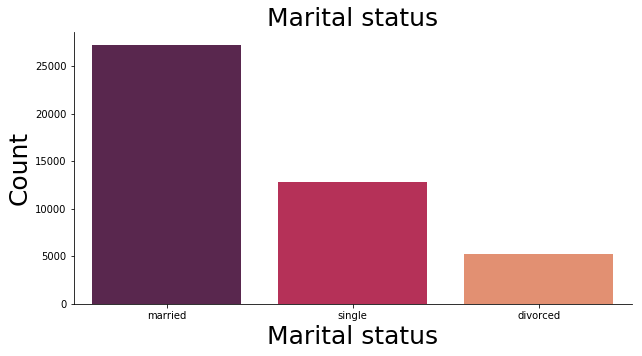

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(10, 5)
sns.countplot(x = 'marital',  palette="rocket", data = org_bank_data)
ax.set_xlabel('Marital status', fontsize=25)
ax.set_ylabel('Count', fontsize=25)
ax.set_title('Marital status', fontsize=25)
sns.despine()

# Pre-Processing

In [0]:
some = bank_data.loc[:, bank_data.dtypes == object].columns
print(some)
with_int = list(set(columns)-set(some))

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'poutcome', 'Target'],
      dtype='object')


<img src = "https://upload.wikimedia.org/wikipedia/commons/thumb/1/1a/Boxplot_vs_PDF.svg/250px-Boxplot_vs_PDF.svg.png">

In [0]:
data = bank_data.copy()
def remove_outlier(df_in, col_name):
  q1 = df_in[col_name].quantile(0.25)
  q3 = df_in[col_name].quantile(0.75)
  iqr = q3-q1 #Interquartile range
  fence_low  = q1-1.5*iqr
  fence_high = q3+1.5*iqr
  df_out = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
  return df_out

In [0]:
for i in with_int:
    if i != 'pdays' and i != 'previous':
      print(i)
      print(data.count())     
      bank_data = remove_outlier(data,i)
      print(data.count())

day
age          45211
job          45211
marital      45211
education    45211
default      45211
balance      45211
housing      45211
loan         45211
contact      45211
day          45211
month        45211
campaign     45211
pdays        45211
previous     45211
poutcome     45211
Target       45211
dtype: int64
age          45211
job          45211
marital      45211
education    45211
default      45211
balance      45211
housing      45211
loan         45211
contact      45211
day          45211
month        45211
campaign     45211
pdays        45211
previous     45211
poutcome     45211
Target       45211
dtype: int64
balance
age          45211
job          45211
marital      45211
education    45211
default      45211
balance      45211
housing      45211
loan         45211
contact      45211
day          45211
month        45211
campaign     45211
pdays        45211
previous     45211
poutcome     45211
Target       45211
dtype: int64
age          45211
job          45211

In [0]:
data = bank_data.copy()
cat_vars=['job','education','default','housing','loan','contact','month','poutcome']
for var in cat_vars:
    cat_list='var'+'_'+var
    cat_list = pd.get_dummies(data[var], prefix=var)
    data1=data.join(cat_list)
    data=data1
cat_vars=['job','education','default','housing','loan','contact','month','poutcome']
data_vars=data.columns.values.tolist()
to_keep=[i for i in data_vars if i not in cat_vars]
data_final=data[to_keep]
data_final.columns.values

array(['age', 'marital', 'balance', 'day', 'campaign', 'pdays',
       'previous', 'Target', 'job_admin.', 'job_blue-collar',
       'job_entrepreneur', 'job_housemaid', 'job_management',
       'job_retired', 'job_self-employed', 'job_services', 'job_student',
       'job_technician', 'job_unemployed', 'job_unknown',
       'education_primary', 'education_secondary', 'education_tertiary',
       'education_unknown', 'default_no', 'default_yes', 'housing_no',
       'housing_yes', 'loan_no', 'loan_yes', 'contact_cellular',
       'contact_telephone', 'contact_unknown', 'month_apr', 'month_aug',
       'month_dec', 'month_feb', 'month_jan', 'month_jul', 'month_jun',
       'month_mar', 'month_may', 'month_nov', 'month_oct', 'month_sep',
       'poutcome_failure', 'poutcome_other', 'poutcome_success',
       'poutcome_unknown'], dtype=object)

In [0]:
labelencoder_X = LabelEncoder()
for col in some:
  print(col)
  labelencoder_X.fit(bank_data[col])
  bank_data[col] = labelencoder_X.transform(bank_data[col])
  print(bank_data.head(10))

job
   age  job   marital  education  ... pdays  previous poutcome Target
0   58    4   married   tertiary  ...    -1         0  unknown     no
1   44    9    single  secondary  ...    -1         0  unknown     no
2   33    2   married  secondary  ...    -1         0  unknown     no
3   47    1   married    unknown  ...    -1         0  unknown     no
4   33   11    single    unknown  ...    -1         0  unknown     no
5   35    4   married   tertiary  ...    -1         0  unknown     no
6   28    4    single   tertiary  ...    -1         0  unknown     no
7   42    2  divorced   tertiary  ...    -1         0  unknown     no
8   58    5   married    primary  ...    -1         0  unknown     no
9   43    9    single  secondary  ...    -1         0  unknown     no

[10 rows x 16 columns]
marital
   age  job  marital  education  ... pdays  previous poutcome Target
0   58    4        1   tertiary  ...    -1         0  unknown     no
1   44    9        2  secondary  ...    -1         0  un

In [0]:
bank_data.head(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,Target
0,58,4,1,2,0,2143,1,0,2,5,8,1,-1,0,3,0
1,44,9,2,1,0,29,1,0,2,5,8,1,-1,0,3,0
2,33,2,1,1,0,2,1,1,2,5,8,1,-1,0,3,0
3,47,1,1,3,0,1506,1,0,2,5,8,1,-1,0,3,0
4,33,11,2,3,0,1,0,0,2,5,8,1,-1,0,3,0
5,35,4,1,2,0,231,1,0,2,5,8,1,-1,0,3,0
6,28,4,2,2,0,447,1,1,2,5,8,1,-1,0,3,0
7,42,2,0,2,1,2,1,0,2,5,8,1,-1,0,3,0
8,58,5,1,0,0,121,1,0,2,5,8,1,-1,0,3,0
9,43,9,2,1,0,593,1,0,2,5,8,1,-1,0,3,0


Removing the outliers

In [0]:
print(with_int)
bank_data['pdays'].unique()
org_bank_data['pdays'].unique()
for i in with_int:
    if i != 'pdays' and i != 'previous':
      print(i)
      print(bank_data.count())
      
      bank_data = remove_outlier(bank_data,i)
      print(bank_data.count())

['day', 'balance', 'campaign', 'age', 'pdays', 'previous']
day
age          44724
job          44724
marital      44724
education    44724
default      44724
balance      44724
housing      44724
loan         44724
contact      44724
day          44724
month        44724
campaign     44724
pdays        44724
previous     44724
poutcome     44724
Target       44724
dtype: int64
age          44724
job          44724
marital      44724
education    44724
default      44724
balance      44724
housing      44724
loan         44724
contact      44724
day          44724
month        44724
campaign     44724
pdays        44724
previous     44724
poutcome     44724
Target       44724
dtype: int64
balance
age          44724
job          44724
marital      44724
education    44724
default      44724
balance      44724
housing      44724
loan         44724
contact      44724
day          44724
month        44724
campaign     44724
pdays        44724
previous     44724
poutcome     44724
Target    

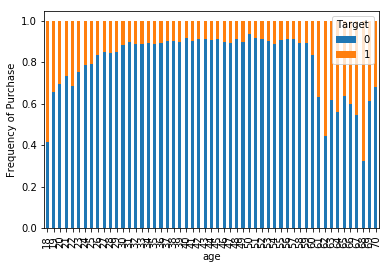

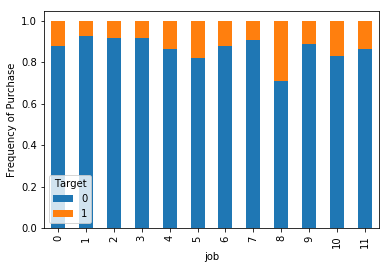

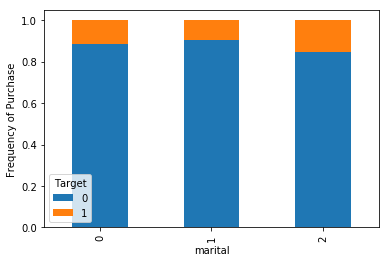

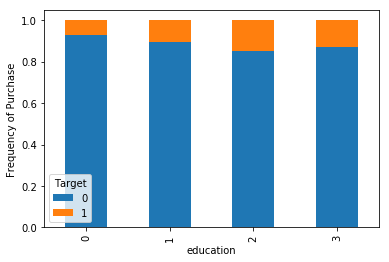

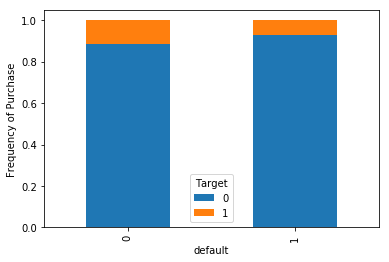

...

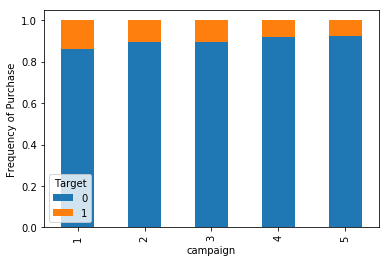

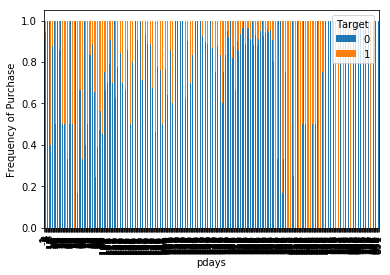

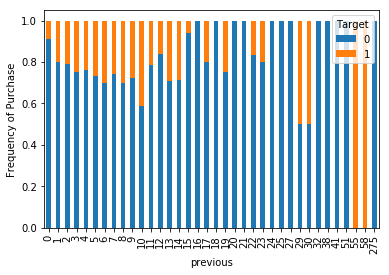

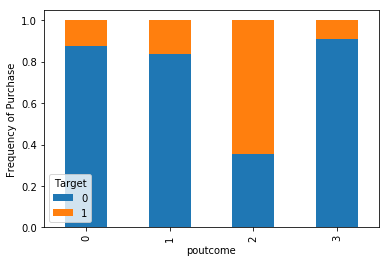

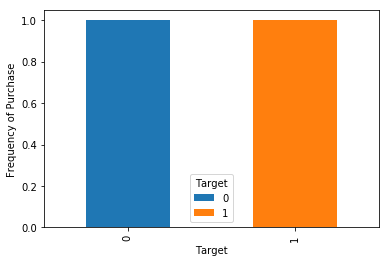

In [0]:
for i in bank_data.columns:
  table=pd.crosstab(bank_data[i],bank_data.Target)
  table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
  plt.xlabel(i)
  plt.ylabel('Frequency of Purchase')

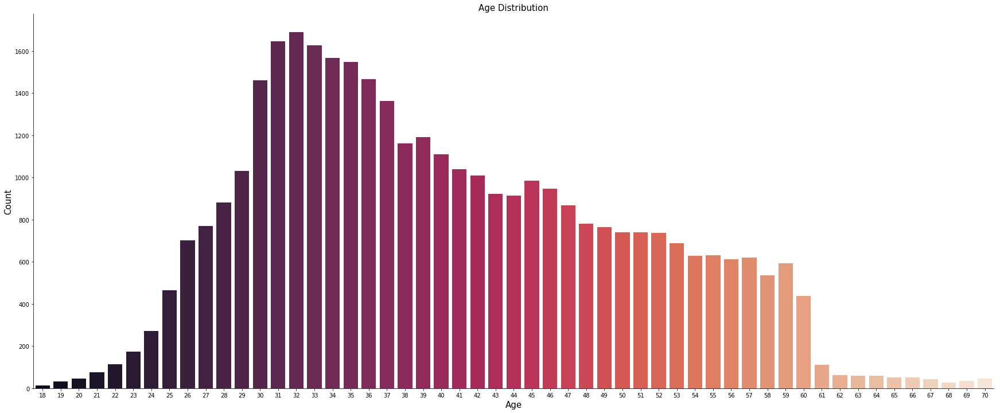

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(30, 12)
sns.countplot(x = 'age',  palette="rocket", data = bank_data)
ax.set_xlabel('Age', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Age Distribution', fontsize=15)
sns.despine()

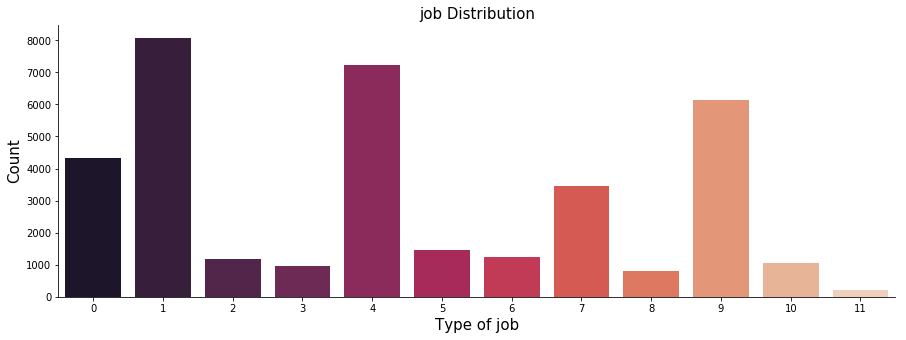

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'job',  palette="rocket", data = bank_data)
ax.set_xlabel('Type of job', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('job Distribution', fontsize=15)
sns.despine()

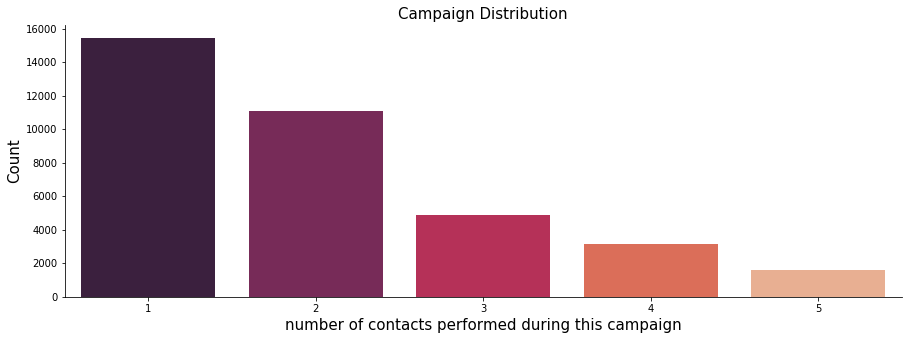

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'campaign',  palette="rocket", data = bank_data)
ax.set_xlabel('number of contacts performed during this campaign', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Campaign Distribution', fontsize=15)
sns.despine()

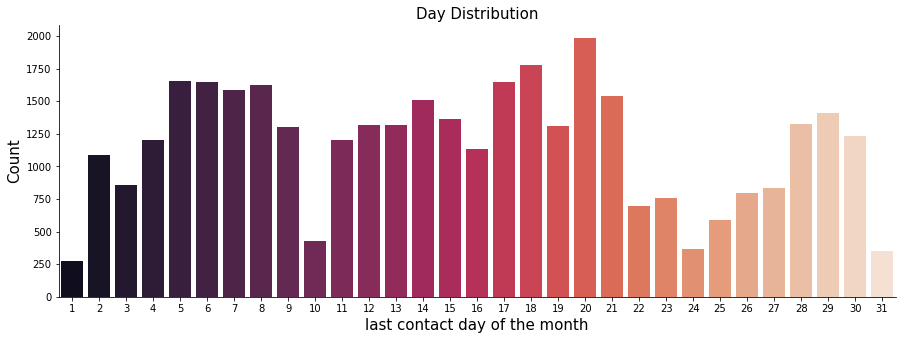

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'day',  palette="rocket", data = bank_data)
ax.set_xlabel('last contact day of the month', fontsize=15)
ax.set_ylabel('Count', fontsize=15)
ax.set_title('Day Distribution', fontsize=15)
sns.despine()

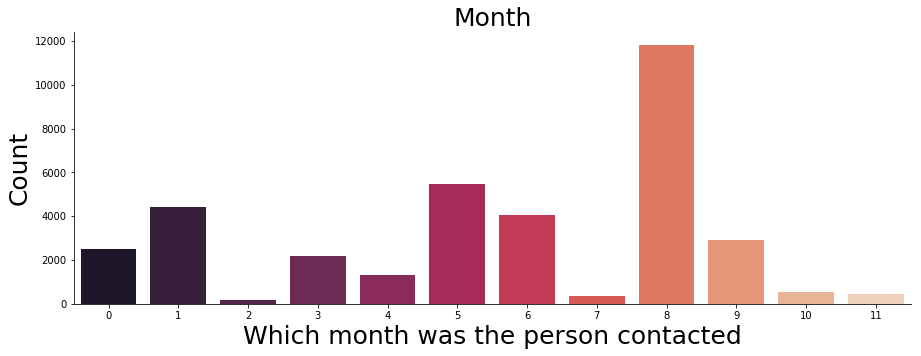

In [0]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 5)
sns.countplot(x = 'month',  palette="rocket", data = bank_data)
ax.set_xlabel('Which month was the person contacted', fontsize=25)
ax.set_ylabel('Count', fontsize=25)
ax.set_title('Month', fontsize=25)
sns.despine()

In [0]:
bank_data.loc[(bank_data['pdays'] == 999), 'pdays'] = 0
bank_data.loc[(bank_data['pdays'] > 0) & (bank_data['pdays'] <= 10), 'pdays'] = 1
bank_data.loc[(bank_data['pdays'] > 10) & (bank_data['pdays'] <= 20), 'pdays'] = 2
bank_data.loc[(bank_data['pdays'] > 20) & (bank_data['pdays'] <= 30), 'pdays'] = 3
bank_data.loc[(bank_data['pdays'] > 30) & (bank_data['pdays'] <= 40), 'pdays'] = 4
bank_data.loc[(bank_data['pdays'] > 40) & (bank_data['pdays'] != 999), 'pdays'] = 5 
print(bank_data['pdays'].unique())

[-1  5  3  1  2  4]


In [0]:
column = ['age', 'balance', 'campaign', 'pdays', 'day', 'previous']
type(bank_data)

pandas.core.frame.DataFrame

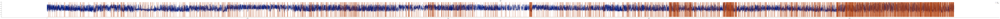

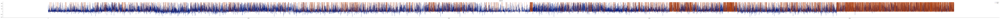

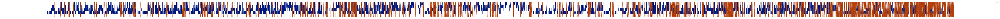

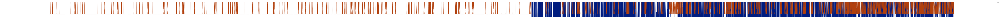

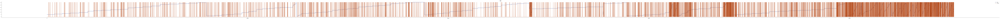

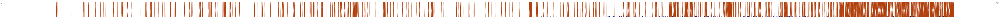

In [0]:
for i in column:
  inte = bank_data[i].max()
  fig, ax = plt.subplots()
  fig.set_size_inches(300, 5)
  sns.lineplot(data = [bank_data[i], bank_data['Target']*inte] ,palette="dark")
  ax.set_title(i, fontsize=15)
  sns.despine()

In [0]:
bank_data.groupby('Target').count()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome
Target,,,,,,,,,,,,,,,
0,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010,32010
1,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133,4133


# Train and test the model

In [0]:
X = bank_data.loc[:, bank_data.columns != 'Target']
X = X.drop(['previous','campaign',"marital"], axis=1)
print(X.columns)
y = bank_data['Target'] 

Index(['age', 'job', 'education', 'default', 'balance', 'housing', 'loan',
       'contact', 'day', 'month', 'pdays', 'poutcome'],
      dtype='object')


In [0]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 0)

In [0]:
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

transform the data in a way that the variance is unitary and that the mean of the series is 0

In [0]:
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

k=1 84.406255
k=2 88.604450
k=3 87.844477
k=4 88.844229
k=5 88.582296
k=6 89.002846
k=7 88.910621
k=8 89.120916
k=9 89.143055
k=10 89.209458
k=11 89.250028
k=12 89.242659
k=13 89.227904
k=14 89.224210
k=15 89.242650
k=16 89.209446
k=17 89.316434
k=18 89.327493
k=19 89.316433
k=20 89.320116
k=21 89.353321
k=22 89.312741
k=23 89.364391
k=24 89.349632
k=25 89.357015
k=26 89.364388
k=27 89.357012
k=28 89.360698
k=29 89.386527
k=30 89.368074
The optimal number of neighbors is 28 with 89.386527


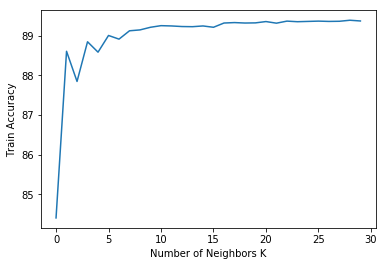

In [0]:
neighbors = np.arange(0,30)
cv_scores = []

#Perform 10-fold cross validation on training set for odd values of k:
for k in neighbors:
    k_value = k+1
    knn = KNeighborsClassifier(n_neighbors = k_value, weights='uniform', p=2, metric='euclidean')
    kfold = model_selection.KFold(n_splits=10, random_state=123)
    scores = model_selection.cross_val_score(knn, X_train, y_train, cv=kfold, scoring='accuracy')
    cv_scores.append(scores.mean()*100)
    print("k=%d %f" % (k_value, scores.mean()*100))

optimal_k = neighbors[cv_scores.index(max(cv_scores))]
print ("The optimal number of neighbors is %d with %f" % (optimal_k, cv_scores[optimal_k]))

plt.plot(neighbors, cv_scores)
plt.xlabel('Number of Neighbors K')
plt.ylabel('Train Accuracy')
plt.show()

In [0]:
knn = KNeighborsClassifier(n_neighbors=22)
knn.fit(X_train, y_train)
knnpred = knn.predict(X_test)

print(accuracy_score(y_test, knnpred)*100)

89.11022576361222


In [0]:
print(X.columns)
X_l = data_final.loc[:, data_final.columns != 'Target']
X_l = X_l.drop(['previous','campaign',"marital"], axis=1)
print(X_l.columns)
print(X_l.columns)
y_l = data_final['Target']
X_l_train, X_l_test, y_l_train, y_l_test = train_test_split(X_l, y_l, test_size = 0.25, random_state = 0)
logmodel = LogisticRegression() 
logmodel.fit(X_l_train,y_l_train)
logpred = logmodel.predict(X_l_test)

print(accuracy_score(y_l_test, logpred)*100)

Index(['age', 'job', 'education', 'default', 'balance', 'housing', 'loan',
       'contact', 'day', 'month', 'pdays', 'poutcome'],
      dtype='object')
Index(['age', 'balance', 'day', 'pdays', 'job_admin.', 'job_blue-collar',
       'job_entrepreneur', 'job_housemaid', 'job_management', 'job_retired',
       'job_self-employed', 'job_services', 'job_student', 'job_technician',
       'job_unemployed', 'job_unknown', 'education_primary',
       'education_secondary', 'education_tertiary', 'education_unknown',
       'default_no', 'default_yes', 'housing_no', 'housing_yes', 'loan_no',
       'loan_yes', 'contact_cellular', 'contact_telephone', 'contact_unknown',
       'month_apr', 'month_aug', 'month_dec', 'month_feb', 'month_jan',
       'month_jul', 'month_jun', 'month_mar', 'month_may', 'month_nov',
       'month_oct', 'month_sep', 'poutcome_failure', 'poutcome_other',
       'poutcome_success', 'poutcome_unknown'],
      dtype='object')
Index(['age', 'balance', 'day', 'pdays', 'job

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


89.72363831499865


In [0]:
import statsmodels.api as sm
x_train_lm = sm.add_constant(X_l)
print(type(x_train_lm))
#print()
y_bla=pd.DataFrame(y_l_train)
print(type(y_l_train))
print(type(y_bla))
y_l_train.head()
#lr = sm.OLS(y_bla, x_train_lm).fit()

# lr.params

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


10725     no
43346    yes
28703     no
17730     no
26222     no
Name: Target, dtype: object

In [0]:
for this_gamma in [.01, 1.0, 10.0]:
    svc= SVC(kernel = 'sigmoid', gamma= this_gamma)
    svc.fit(X_train, y_train)
    svcpred = svc.predict(X_test)
    print(accuracy_score(y_test, svcpred)*100)

88.0920761398849
79.00619743249226
79.36033643204958


In [0]:
dtree = DecisionTreeClassifier(criterion='gini') #criterion = entopy, gini
dtree.fit(X_train, y_train)
dtreepred = dtree.predict(X_test)

print(accuracy_score(y_test, dtreepred)*100)

82.59185480301018


In [0]:
rfc = RandomForestClassifier(n_estimators = 200)#criterion = entopy,gini
rfc.fit(X_train, y_train)
rfcpred = rfc.predict(X_test)

print(accuracy_score(y_test, rfcpred)*100)

89.15449313855687
